In [1]:
from IPython.core.display import display, HTML
display(HTML("<style>.container { width:100% !important; }</style>"))

In [2]:
## importing stuff
import os
import pickle
from sys import path as syspath
syspath.append(os.path.expanduser("~/srdjan_functs/"))

import numpy as np
np.corrcoef(*np.random.randn(2,3))

import matplotlib.pyplot as plt
%config InlineBackend.figure_format = 'retina'
%load_ext autoreload
%autoreload 2

from IPython.display import display
import pandas as pd
from islets.Recording import Recording, saveMovie, parse_leica
from islets.numeric import power_spectrum, rebin
from islets.utils import show_movie, saveRois
from matplotlib.colors import LogNorm

In [3]:
import javabridge
from bioformats import JARS as bfJARS
javabridge.start_vm(class_path=bfJARS, max_heap_size="20G")

In [4]:
%%capture
from tqdm.notebook import tqdm
tqdm().pandas()

In [26]:
recordings = []
for cur,ds,fs in os.walk("/data/"):
    for f in fs:
        if not f.endswith(".lif"):
            continue
        path = os.path.join(cur,f)
        recordings += [path]
recordings = sorted(recordings)

In [27]:
len(recordings)

970

In [28]:
for path in tqdm(recordings):
    rec = Recording(path)
    if "line scan" in rec.metadata: continue
#     print (path)
    rec.parse_metadata()
    rec.tag_linescans(verbose=True)
    rec.save_metadata()

Recording /data/Johannes/2020_09_17/Experiment008b.lif not yet preprocessed. Preprocessing takes a few seconds and will speed up the usage later... Finished.
Recording /data/Marjan/Jure/Glucose_dependence_TW/2020 03 06 NMRI 10 Hz exp1.lif not yet preprocessed. Preprocessing takes a few seconds and will speed up the usage later... Finished.
Recording /data/Marjan/Jure/Glucose_dependence_TW/2020 03 06 NMRI 10 Hz exp2.lif not yet preprocessed. Preprocessing takes a few seconds and will speed up the usage later... Finished.
Recording /data/Marjan/Jure/Glucose_dependence_TW/2020 03 06 NMRI 10 Hz exp3.lif not yet preprocessed. Preprocessing takes a few seconds and will speed up the usage later... Finished.
Recording /data/Marjan/Jure/Glucose_dependence_TW/2020 03 06 NMRI 10 Hz exp4.lif not yet preprocessed. Preprocessing takes a few seconds and will speed up the usage later... Finished.
Recording /data/Marjan/Jure/Glucose_dependence_TW/2020 03 06 NMRI 10 Hz exp5.lif not yet preprocessed. Pre

Recording /data/Marjan/MB/Cytokines/cytokines-7-10Hz/cytokines-7-10Hz.lif not yet preprocessed. Preprocessing takes a few seconds and will speed up the usage later... Finished.
Recording /data/Marjan/MB/Cytokines/cytokines-8-10Hz/cytokines-8-10Hz.lif not yet preprocessed. Preprocessing takes a few seconds and will speed up the usage later... Finished.
Recording /data/Marjan/MB/MK801/lidija-9glu-TOLB-HF-1.lif not yet preprocessed. Preprocessing takes a few seconds and will speed up the usage later... Finished.
Recording /data/Marjan/MB/MK801/lidija-9glu-TOLB-HF-2.lif not yet preprocessed. Preprocessing takes a few seconds and will speed up the usage later... Finished.
Recording /data/Marjan/MB/MK801/lidija-MK801-1.lif not yet preprocessed. Preprocessing takes a few seconds and will speed up the usage later... Finished.
Recording /data/Marjan/MB/MK801/lidija-MK801-2.lif not yet preprocessed. Preprocessing takes a few seconds and will speed up the usage later... Finished.
Recording /data/

Recording /data/Marjan/MB/thapsigargin-OGB/lidija46-NMRI-glu-10nMthapsigargin.lif not yet preprocessed. Preprocessing takes a few seconds and will speed up the usage later... Finished.
Recording /data/Marjan/MB/thapsigargin-OGB/lidija47-NMRI-glu-10nMthapsigargin.lif not yet preprocessed. Preprocessing takes a few seconds and will speed up the usage later... Finished.
Recording /data/Marjan/MB/thapsigargin-OGB/lidija48-NMRI-glu-10nMthapsigargin.lif not yet preprocessed. Preprocessing takes a few seconds and will speed up the usage later... Finished.
Recording /data/Marjan/MB/thapsigargin-OGB/lidija49-NMRI-thapsigargin.lif not yet preprocessed. Preprocessing takes a few seconds and will speed up the usage later... Finished.
Recording /data/Marjan/MB/thapsigargin-OGB/lidija50-NMRI-thapsigargin.lif not yet preprocessed. Preprocessing takes a few seconds and will speed up the usage later... Finished.
Recording /data/Marjan/MB/tolbutamide-OGB/12Feb2014_glc+tolb.lif not yet preprocessed. Prep

/home/jupyter-srdjan/srdjan_functs/islets/Recording.py:131: UserWarning: Could not parse metadata.
  warn("Could not parse metadata.")


AttributeError: 'Recording' object has no attribute 'metadata'

In [24]:
rec.metadata

,Name,SizeT,SizeX,SizeY,SizeZ,pxSize,pxUnit,bit depth,Frequency,Start time,End time,Duration,line scan
0,Image004,1,1024,1024,1,0.295444,µm,uint8,NaN,2017-08-01 07:00:42,NaT,NaT,none
1,Series006,4290,512,512,1,0.591466,µm,uint8,1.979516,2017-08-01 07:01:33,2017-08-01 07:37:40.195999146,0 days 00:36:07.195999146,none


In [10]:
# for path in tqdm(recordings):
#     rec = Recording(path)
#     if not rec.metadata["Start time"].isna().loc[0]: continue
#     rec.parse_metadata()
#     rec.save_metadata()

In [11]:
# %%capture
# from ExpLorer_7 import import_data

In [12]:
from islets.Recording import import_data

In [14]:
status = import_data("/data/Sandra/2019/2019_09_03/","lif", verbose=True)

#################### /data/Sandra/2019/2019_09_03/Experiment31.lif
#################### /data/Sandra/2019/2019_09_03/Experiment31b.lif



In [16]:
pd.set_option('display.max_columns', 50)

In [17]:
status

,path to exp,experiment,series,SizeT,SizeX,SizeY,SizeZ,pxSize,pxUnit,Frequency,Duration,line scan,gap,Time Range,Duration [s],path to movie,movie done,movie size [MB],date,Series Durations,pickles done,path to protocol,protocol done,protocol,path to add_info,add_info done,comments,sex,strain,species,dye,slice number,part of pancreas,microscope
0,/data/Sandra/2019/2019_09_03/Experiment31.lif,Experiment31.lif,Series009,1222,512,512,1,0.519,µm,1.98,0 days 00:10:16.122999191,none,NaN,all,617.171717,/data/Sandra/2019/2019_09_03/Experiment31.lif_...,True,63.2,2019-09-03,9 [00:00-10:16],"{(11,): True, (13,): True, (11, 13): True, (11...",/data/Sandra/2019/2019_09_03/Experiment31.lif_...,True,Glu:6mM Ryanodine:100nM,/data/Sandra/2019/2019_09_03/Experiment31.lif_...,True,good,m,NMRI,mouse,Calbryte520,1,nan,upright SP5
1,/data/Sandra/2019/2019_09_03/Experiment31.lif,Experiment31.lif,Series015,1333,512,512,1,0.505,µm,1.98,0 days 00:11:12.367000580,none,1465.0,all,673.232323,/data/Sandra/2019/2019_09_03/Experiment31.lif_...,True,75.2,2019-09-03,15 [00:00-11:12],"{(11,): True, (13,): True, (11, 13): True, (11...",/data/Sandra/2019/2019_09_03/Experiment31.lif_...,True,Glu:6mM Ryanodine:100nM,/data/Sandra/2019/2019_09_03/Experiment31.lif_...,True,good,m,NMRI,mouse,Calbryte520,2,nan,upright SP5
2,/data/Sandra/2019/2019_09_03/Experiment31.lif,Experiment31.lif,Series020-40,210,512,8000,1,0.396,µm,2.20,0 days 00:00:04.546998978,single,66.0,all,95.454545,/data/Sandra/2019/2019_09_03/Experiment31.lif_...,False,NaN,2019-09-03,20 [00:00-4] \n21 [4-9] \n22 [9-13] \n23 [13-1...,"{(14,): False, (16,): False, (14, 16): False, ...",/data/Sandra/2019/2019_09_03/Experiment31.lif_...,True,Glu:6mM Ryanodine:100nM,/data/Sandra/2019/2019_09_03/Experiment31.lif_...,True,good line scan,m,NMRI,mouse,Calbryte520,2,nan,upright SP5
3,/data/Sandra/2019/2019_09_03/Experiment31.lif,Experiment31.lif,Series041,690,512,512,1,0.396,µm,1.31,0 days 00:08:48.279998779,none,13.0,all,526.717557,/data/Sandra/2019/2019_09_03/Experiment31.lif_...,True,40.1,2019-09-03,41 [00:00-8:48],"{(14,): True, (16,): True, (14, 16): True, (14...",/data/Sandra/2019/2019_09_03/Experiment31.lif_...,True,Glu:6mM Ryanodine:100nM Ryanodine:10uM,/data/Sandra/2019/2019_09_03/Experiment31.lif_...,True,good,m,NMRI,mouse,Calbryte520,2,nan,upright SP5
4,/data/Sandra/2019/2019_09_03/Experiment31.lif,Experiment31.lif,Series044-45,157,512,512,1,0.396,µm,31.10,0 days 00:00:05.042999268,single,100.0,all,5.048232,/data/Sandra/2019/2019_09_03/Experiment31.lif_...,True,0.9,2019-09-03,44 [00:00-5],"{(14,): True, (16,): True, (14, 16): True, (14...",/data/Sandra/2019/2019_09_03/Experiment31.lif_...,True,Glu:6mM Ryanodine:10uM,/data/Sandra/2019/2019_09_03/Experiment31.lif_...,True,good line scan,m,NMRI,mouse,Calbryte520,2,nan,upright SP5
5,/data/Sandra/2019/2019_09_03/Experiment31.lif,Experiment31.lif,Series046,157,512,512,1,0.396,µm,31.10,0 days 00:00:05.043001175,single,20.0,all,5.048232,/data/Sandra/2019/2019_09_03/Experiment31.lif_...,True,0.8,2019-09-03,46 [00:00-5],"{(14,): True, (16,): True, (14, 16): True, (14...",/data/Sandra/2019/2019_09_03/Experiment31.lif_...,True,Glu:6mM Ryanodine:10uM,/data/Sandra/2019/2019_09_03/Experiment31.lif_...,True,good line scan,m,NMRI,mouse,Calbryte520,2,nan,upright SP5
6,/data/Sandra/2019/2019_09_03/Experiment31.lif,Experiment31.lif,Series048-52,785,512,512,1,0.396,µm,31.10,0 days 00:00:05.042999268,single,35.0,all,25.241158,/data/Sandra/2019/2019_09_03/Experiment31.lif_...,True,4.8,2019-09-03,48 [00:00-5] \n49 [5-10] \n50 [10-15] \n51 [15...,"{(14,): True, (16,): True, (14, 16): True, (14...",/data/Sandra/2019/2019_09_03/Experiment31.lif_...,True,Glu:6mM Ryanodine:10uM,/data/Sandra/2019/2019_09_03/Experiment31.lif_...,True,good line scan,m,NMRI,mouse,Calbryte520,2,nan,upright SP5
7,/data/Sandra/2019/2019_09_03/Experiment31.lif,Experiment31.lif,Series060,14,512,512,1,0.396,µm,1.52,0 days 00:00:09.215000153,none,20.0,all,9.210526,/data/Sandra/2019/2019_09_03/Experiment31.lif_.

In [67]:
from islets.utils import get_series_dir

In [76]:
get_series_dir("/data/Sandra/2020/2020_09_08/Experiment65b.lif", "Series006-9")

['Series006-9']

In [71]:
rec = Recording("/data/Sandra/2020/2020_09_08/Experiment65b.lif")

In [73]:
rec.calc_gaps()

In [74]:
rec.metadata

,Name,SizeT,SizeX,SizeY,SizeZ,pxSize,pxUnit,bit depth,Frequency,Start time,End time,Duration,line scan,gap
0,Series006,32000,256,256,1,1.62,µm,uint8,19.4,2020-09-08 10:32:21,2020-09-08 10:59:49,0 days 00:27:28.496000290,none,NaN
1,Series007,32000,256,256,1,1.62,µm,uint8,19.4,2020-09-08 10:59:50,2020-09-08 11:27:18,0 days 00:27:28.544000626,none,1.0
2,Series008,32000,256,256,1,1.62,µm,uint8,19.4,2020-09-08 11:27:19,2020-09-08 11:54:47,0 days 00:27:28.575000763,none,1.0
3,Series009,49,256,256,1,1.62,µm,uint8,19.8,2020-09-08 11:54:48,2020-09-08 11:54:50,0 days 00:00:02.472999573,none,1.0


In [79]:
from caiman import load as cload

In [80]:
movie = cload("/data/Sandra/2020/2020_10_06_Sandra_beta_cells/Dish_1_REC_1_Baseline_5_min_25pcLED_1_Hz.tif")

In [81]:
show_movie(movie[:10], )

In [9]:
from nd2reader import ND2Reader

In [10]:
with ND2Reader(rec.path) as nd2data:
    date = nd2data.metadata['date']

OSError: [Errno 22] Invalid argument

In [45]:
date

datetime.datetime(2020, 10, 12, 14, 47, 26)

In [61]:
rec.metadata

,Name,SizeT,SizeX,SizeY,SizeZ,pxSize,pxUnit,bit depth,Frequency,Start time,End time,Duration
0,Experiment010a.nd2 (series 1),58960,256,256,1,1.24,µm,uint16,58.6,NaT,NaT,0 days 00:16:46.462329168


In [62]:
rec.parse_metadata()

In [63]:
rec.metadata

,Name,SizeT,SizeX,SizeY,SizeZ,pxSize,pxUnit,bit depth,Frequency,Start time,End time,Duration
0,Experiment010a.nd2 (series 1),58960,256,256,1,1.242961,µm,uint16,58.581428,2020-10-12 14:47:26,2020-10-12 15:04:12.462329168,0 days 00:16:46.462329168


In [31]:
status["protocol"]  = status["protocol"].astype(str)

KeyError: 'protocol'

In [19]:
phExperiments = status[["pH" in p for p in status["protocol"]]]

In [20]:
phExperiments.sort_values("experiment",ascending=False)#.shape

,path to exp,experiment,series,SizeT,SizeX,SizeY,SizeZ,pxSize,pxUnit,Frequency,...,gap,movie size [MB],comments,sex,strain,species,dye,slice number,part of pancreas,microscope
1,/data/Sandra/2020/2020_07_15/Experiment60b.lif,Experiment60b.lif,Series007-10,48968,256,256,1,0.967,µm,4.55,...,NaN,10.9,motion correction did not help much. need to d...,nan,nan,nan,nan,nan,nan,nan
2,/data/Sandra/2020/2020_07_15/Experiment60b.lif,Experiment60b.lif,Series007-10,48968,256,256,1,0.967,µm,4.55,...,NaN,236.9,motion correction did not help much. need to d...,nan,nan,nan,nan,nan,nan,nan


In [5]:
folder = "/data/Sandra/2019/2019_08_27/"

In [25]:
# rec = Recording("/data/Sandra/2019/2019_08_13/Experiment29.lif")
rec = Recording(folder+"Experiment30.lif")

In [26]:
# rec.parse_metadata()

In [27]:
rec.metadata

,Name,SizeT,SizeX,SizeY,SizeZ,pxSize,pxUnit,bit depth,Frequency,Start time,End time,Duration
0,Image006,1,1024,1024,1,0.243,µm,uint8,NaN,2019-08-27 09:44:57,NaT,NaT
1,Image010,1,1024,1024,1,0.324,µm,uint8,NaN,2019-08-27 09:49:28,NaT,NaT
2,Image012,1,1024,1024,1,0.324,µm,uint8,NaN,2019-08-27 09:50:10,NaT,NaT
3,Series013,7583,512,512,1,0.648,µm,uint8,1.980,2019-08-27 09:50:40,2019-08-27 10:54:27,01:03:47.360729
4,Image017,1,1024,1024,1,0.241,µm,uint8,NaN,2048-03-12 10:41:23,NaT,NaT
5,Image018,1,1024,1024,1,0.241,µm,uint8,NaN,2019-08-27 11:04:23,NaT,NaT
6,Series019,2037,512,512,1,0.482,µm,uint8,1.980,2019-08-27 11:05:13,2019-08-27 11:22:20,00:17:07.631483
7,Image021,1,1024,1024,1,0.424,µm,uint8,NaN,2019-08-27 11:25:48,NaT,NaT
8,Series022,1,1024,1024,1,0.424,µm,uint8,NaN,2048-03-12 11:03:52,NaT,NaT
9,Series023,984,512,512,1,0.850,µm,uint8,1.980,2019-08-27 11:26:47,2019-08-27 11:35:03,00:08:16.318387


In [28]:
nameDict = dict([(name, list(ii)) for ii, name in parse_leica(rec, index=True)])

In [30]:
ser = 'Series035-37'

In [31]:
indices = nameDict[ser]

In [32]:
serNames = rec.metadata.loc[indices,"Name"]

In [37]:
from islets.LineScan import LineScan

In [33]:
for name in serNames:
    rec.import_series(name, isLineScan=True)
    break

In [ ]:
rec.path

In [69]:
linescan = LineScan(
    data = rec.Series[name]["data"][:,0].T,
    metadata = rec.Series[name]["metadata"],
    name = "%s: %s"%(rec.Experiment[:-4], name)
    )

80
rebinning by 80


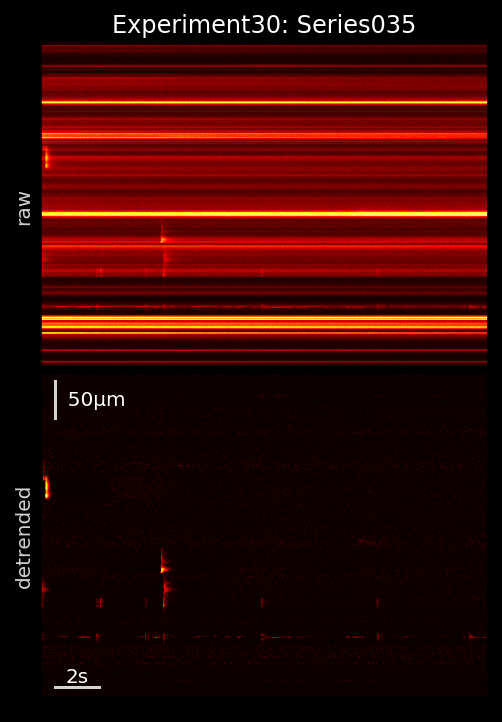

In [76]:
linescan.plot(save=False, Npoints=1000, verbose=True)

In [67]:
linescan.time[-1]

0.12904040404040404

In [14]:
tmax = rec.metadata.loc[indices,'Duration'].max().total_seconds()
tmax

20.196666718

In [15]:
physicalSize = metadata[['SizeX','pxSize']].prod()
physicalSize

435.2

In [16]:
freq = metadata.Frequency

In [19]:
distance = distances[np.searchsorted(distances, physicalSize*.15)-1]

In [20]:

Tind = times[np.searchsorted(times, tmax*.2)-1]
Tind

2

In [47]:
linescan = LineScan(data.T,freq)

In [48]:
linescan.infer_gain(plot=True)

In [49]:
linescan.gain

6.294496271973617

In [50]:
linescan.__dict__.keys()

dict_keys(['data', 'Freq', 'time', 'gain'])

<IPython.core.display.Javascript object>


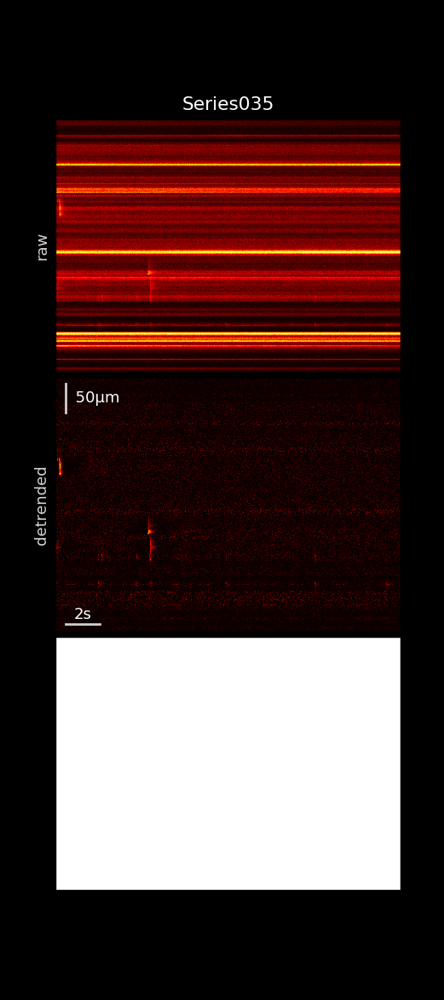

In [51]:
txtOffset = physicalSize-1.2*distance
nr =2*len(timeScales)-1
fig, axs = plt.subplots(nr,1,
                        figsize=(4,3*nr),
                        sharey=True, 
                        sharex=True
                       )
fig.patch.set_facecolor('k')
plt.subplots_adjust(wspace=.02, hspace=.02)

x = data.T.copy()
for it in range(len(timeScales)):
    ts = timeScales[it]
    if ts is None:
        txt = "raw"
        zs = [False]
    else:
        txt = "detrended"
        zs = [False, True]
        sf = sosFilter(1/ts,freq)
        n = int(1.5*ts*freq)
        x = np.hstack([x[:,:n][:,::-1],x])
        xslow = sf.run(x)[:,n:]
        x = x[:,n:]-xslow
    ax = axs[it]
    
    ax.set_yticks([])
    ax.set_xticks([])
    ax.imshow(rebin(x,10,1),extent=(0, x.shape[1]/freq,0,physicalSize,),
              aspect="auto",
              cmap="hot",
              vmin=0
             )
    ax.set_ylabel(txt,color="lightgrey")
    if it==len(timeScales)-1:
        ax.plot([tmax*.03]*2,[txtOffset,txtOffset+distance],"lightgrey")
        ax.text(tmax*.03,txtOffset+distance/2,"  "+str(distance)+"µm", va="center", color="w")
        ax.plot([tmax*.03, tmax*.03+Tind],[.03*physicalSize]*2,"lightgrey")
        ax.text(tmax*.03+Tind/2,.03*physicalSize,str(Tind)+"s\n", ha="center", va="center", color="w")
    if it==0:
        ax.set_title(name,color='w')


In [39]:
%matplotlib notebook

In [71]:
s,f,z = linescan.fast_filter_traces(2, z_sp=4, verbose=True, write=False, dilation=False)

fig, axs = plt.subplots(1,3,figsize=(10,3), sharex=True, sharey=True)
axs[0].imshow(np.log10(s),aspect="auto")
axs[1].imshow(f, aspect="auto")
axs[2].imshow(z, aspect="auto", vmax=10)

introducing reflecting boundary 7920 points wide.
this changed the shape of the input array to (512, 95840)


AssertionError: 

In [ ]:
plt.figure()
plt.hist(z.flat,100,log=True);

In [61]:
i = np.squeeze(np.where(s== s.min()))[0]

In [65]:
s.min()

0.0

In [64]:
i.shape

(8180,)

<IPython.core.display.Javascript object>


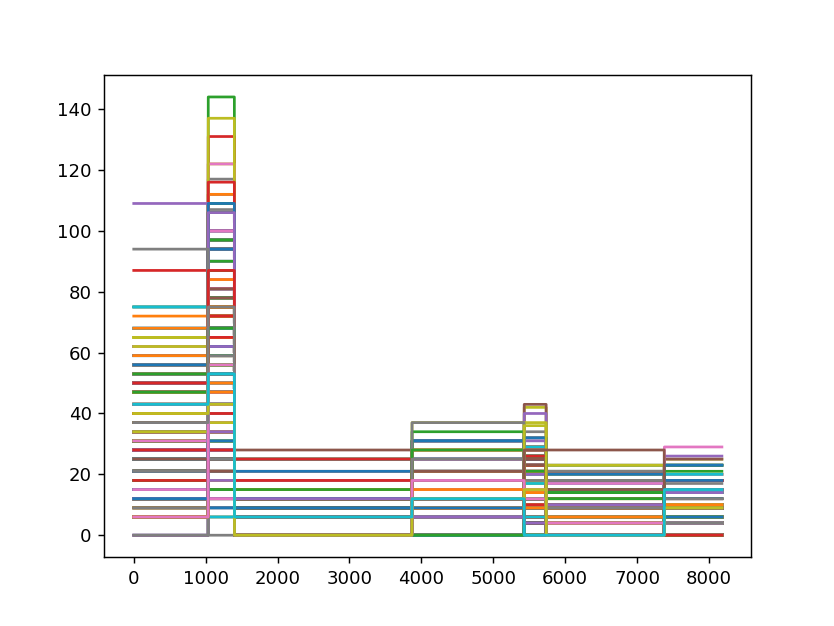

In [62]:
plt.figure()
n = 1000
plt.plot(linescan.data[i,:n])

In [431]:
data.shape

(80000, 512)

In [650]:
linescan = LineScan(data.T.astype("float"), freq=freq)

initial estimate of the gain is 6.294496271973617


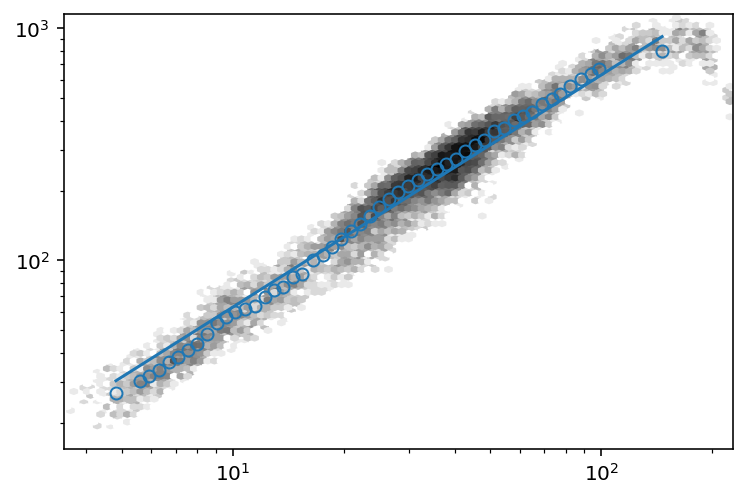

In [651]:
linescan.infer_gain(plot=True, verbose=True)

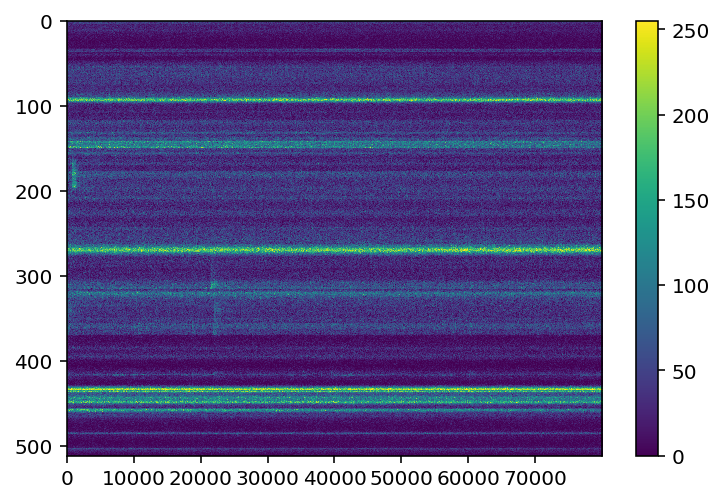

In [652]:
plt.imshow(linescan.data, aspect="auto")
plt.colorbar()

In [653]:
linescan.gain

6.294496271973617

introducing reflecting boundary 3960 points wide.
this changed the shape of the input array to (512, 87920)


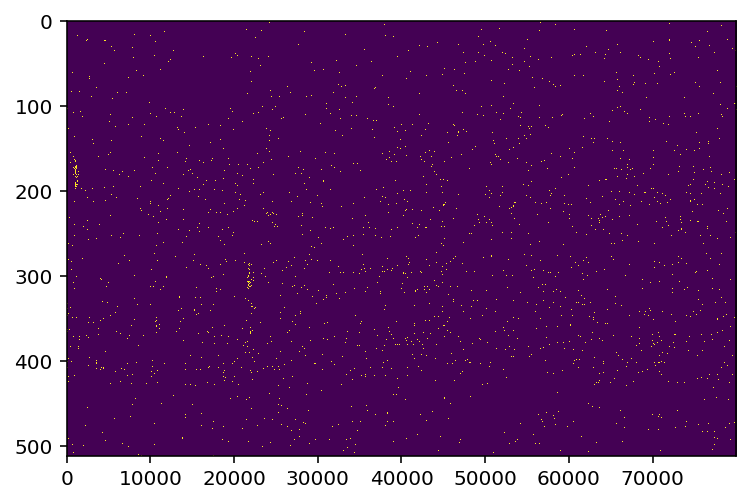

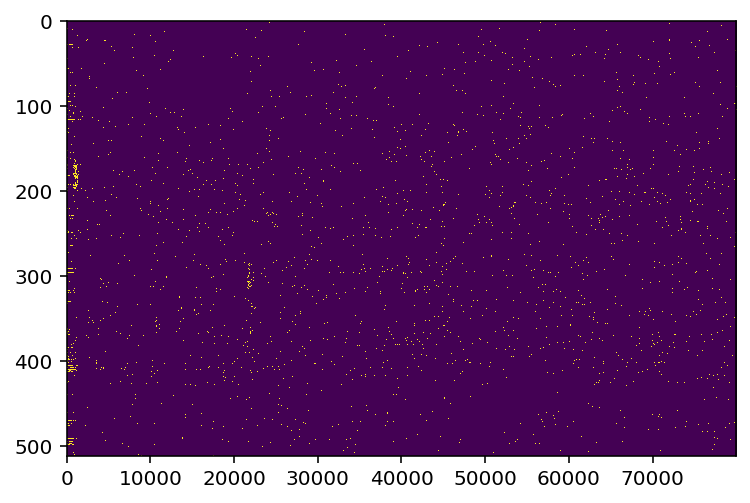

In [654]:
linescan.fast_filter_traces(1, verbose=True, z_sp=3)

In [655]:
x = rebin(linescan.zScore_1,10,1)[:,:1000]

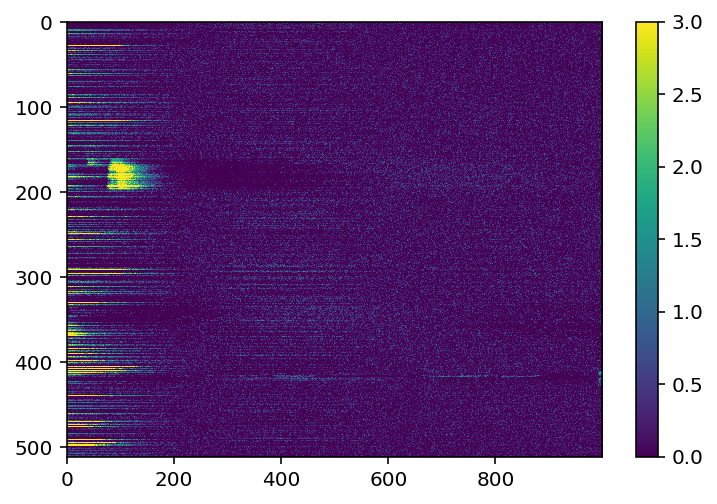

In [633]:
plt.imshow(rebin(linescan.zScore_1,10,1)[:,:1000], aspect="auto", vmin=0, vmax=3)
plt.colorbar()

In [657]:
i = np.squeeze(np.where(x==x.min()))[0]

In [669]:
linescan.data[[i]].shape

(1, 80000)

In [699]:
linescan.gain

6.294496271973617

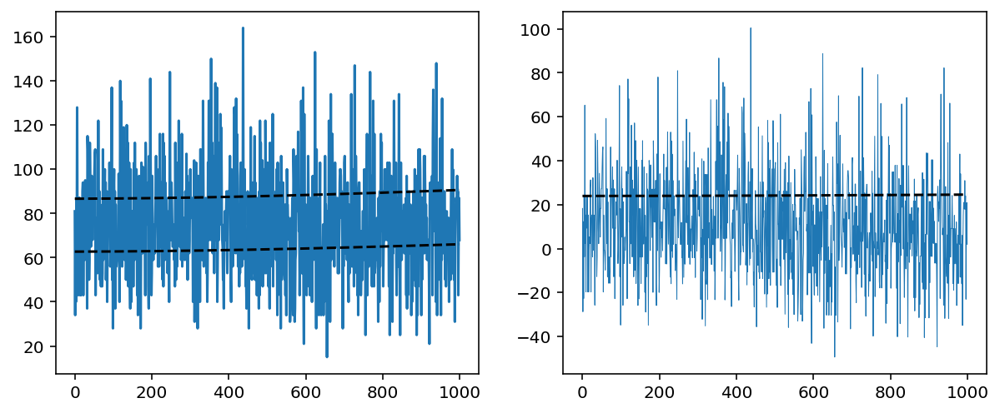

In [698]:
# n = 100
# plt.plot(linescan.data[i,:n])
# plt.plot(linescan.slower_1[i,:n])
fig, axs = plt.subplots(1,2,figsize=(10,4))
x_slow = fast_filter(linescan.data[[i+10]], ironTimeScale=linescan.Freq, dilation=False, npass=0, debugAx=(axs,1000))[0][0]
# plt.plot(x_slow[:n])
# plt.xlim(0,n)

In [695]:
3*60**.5

23.237900077244504

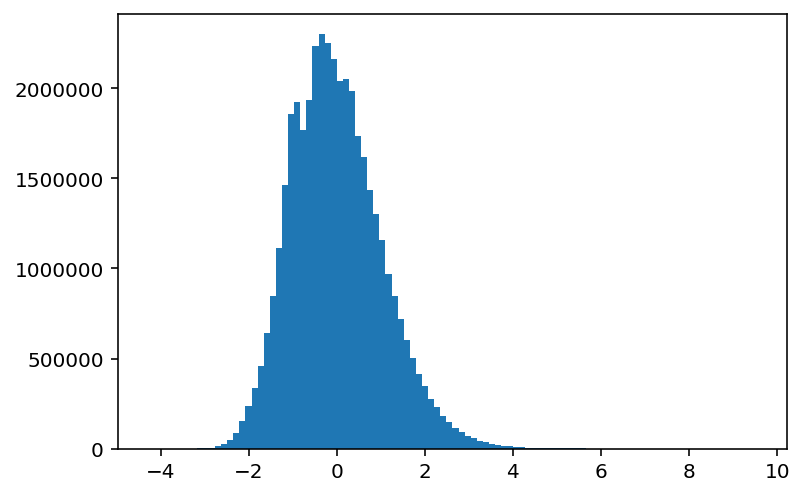

In [588]:
plt.hist(linescan.zScore_2.flat,100);

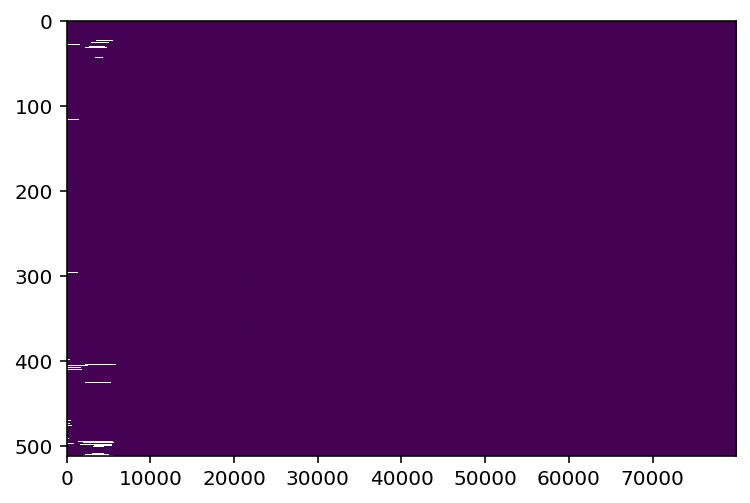

In [566]:
plt.imshow(linescan.zScore_2, aspect="auto")

In [544]:
# linescan.fast_filter_traces(1, z_sp=0, verbose=True,)
sl, fs, _ = fast_filter(linescan.data.astype("float32"), 1, freq=freq, z_sp=0, verbose=True, nreflect="auto")

introducing reflecting boundary 3960 points wide.
this changed the shape of the input array to (512, 87920)


In [545]:
sl.min()

3.9938578169512566

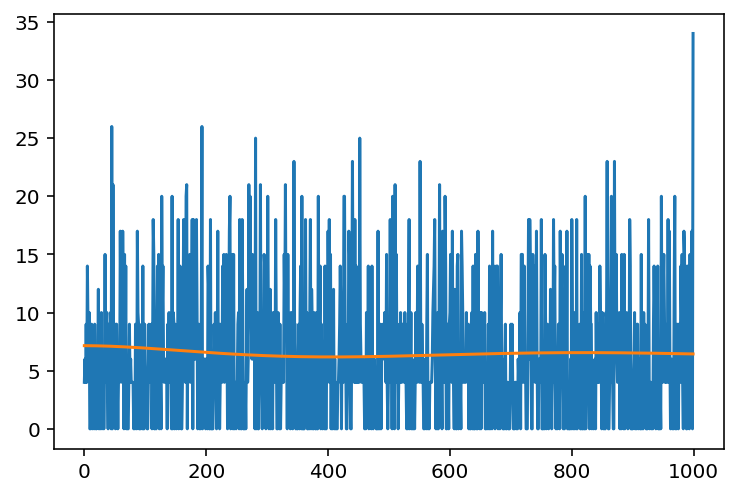

In [546]:
i = 22
plt.plot(linescan.data[i,:10000:10])
plt.plot(sl[i,:10000:10])

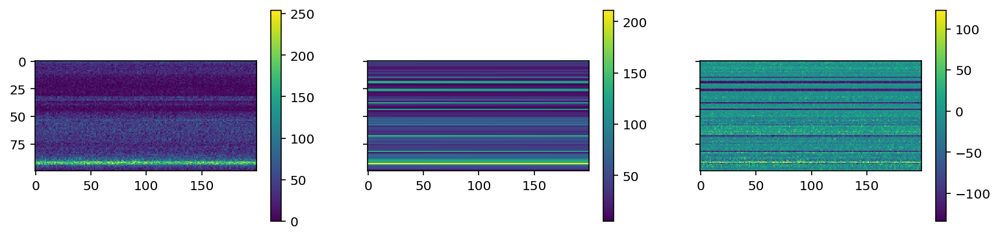

In [516]:
fig, axs = plt.subplots(1,3,figsize=(13,3), sharex=True, sharey=True)# plt.imshow(linescan.data[:100,:300])
for ax, x in zip(axs, [linescan.data, sl, fs]):
    plt.colorbar(ax.imshow(x[:100,:200]), ax=ax)

In [92]:
from islets.numeric import fast_filter

In [102]:
# fast_filter?

In [414]:
X = np.random.randn(30,500)*9**.5+9
X[14,200:] += np.exp(-np.arange(300)*.1)*100

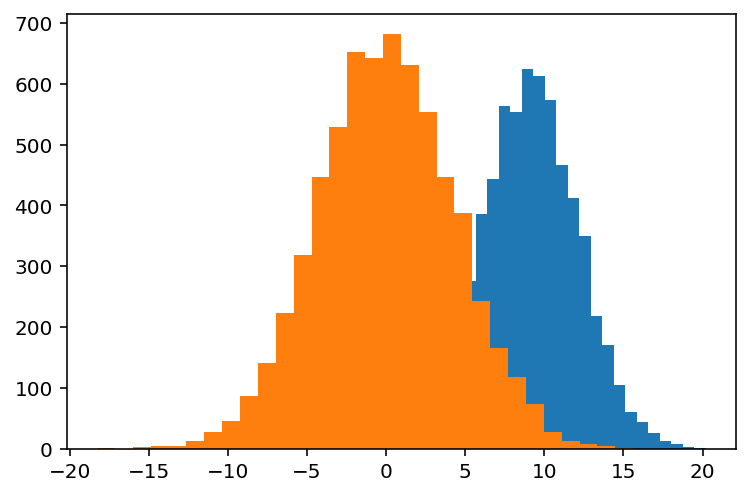

In [415]:
plt.hist(X[:13].flat,30);
plt.hist(np.diff(X, axis=1)[:13].flat,30);

dilating by 21
dilating by 21
dilating by 21


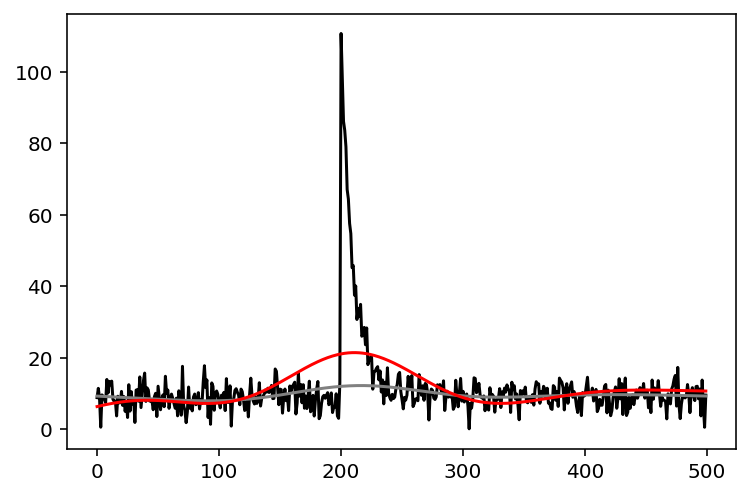

In [429]:
x = X[14]
plt.plot(x,"k")
for n in [3]:
    x_slow, x_fast, x_z = fast_filter(x.reshape(1,-1),100,z_sp=3, freq=1, verbose=True, npass=n)
    plt.plot(x_slow[0],"grey")
    x_slow, x_fast, x_z = fast_filter(x.reshape(1,-1),100,z_sp=3, freq=1, verbose=True, npass=n, dilation=False)
    plt.plot(x_slow[0],"r")

0.6669366995775452
dilating by 5
-1.3649191790032158
dilating by 5
dilating by 5
dilating by 5
0.39930323544083446


/home/jupyter-srdjan/srdjan_functs/islets/numeric.py:49: RuntimeWarning:

invalid value encountered in sqrt

/home/jupyter-srdjan/srdjan_functs/islets/numeric.py:31: RuntimeWarning:

invalid value encountered in greater



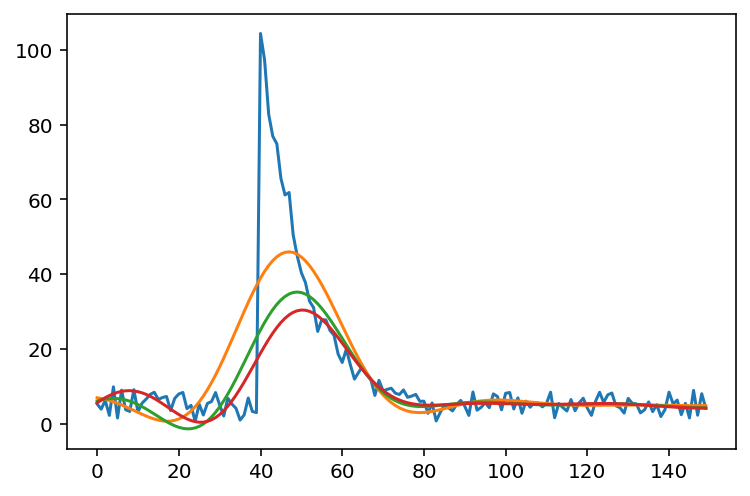

In [373]:

plt.plot(X[14])
x_slow, x_fast, x_z = fast_filter(X,20,z_sp=0, freq=1, verbose=True)
print (x_slow.min())
plt.plot(x_slow[14])
x_slow, x_fast, x_z = fast_filter(X,20,z_sp=3, freq=1, verbose=True)
print (x_slow.min())
plt.plot(x_slow[14])
x_slow, x_fast, x_z = fast_filter(X,20,z_sp=3, freq=1, verbose=True, npass=3)
print (x_slow.min())
plt.plot(x_slow[14])

In [364]:
x_slow.min()

1.5572199812170553

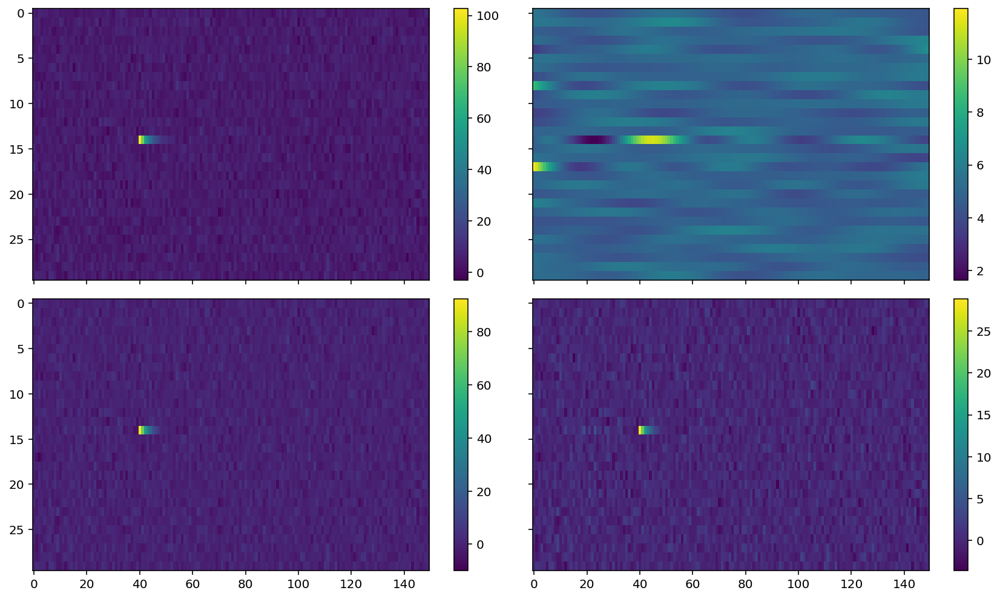

In [367]:
fig, axs = plt.subplots(2,2,figsize=(12,7), sharex=True, sharey=True)
for ax,x_ in zip(axs.flat, [X, x_slow, x_fast, x_z]):
    plt.colorbar(ax.imshow(x_, aspect="auto"),ax=ax)
plt.tight_layout()

In [360]:
i,tmin = np.squeeze(np.where(x_slow==x_slow.min()))
i, tmin

(10, 15)

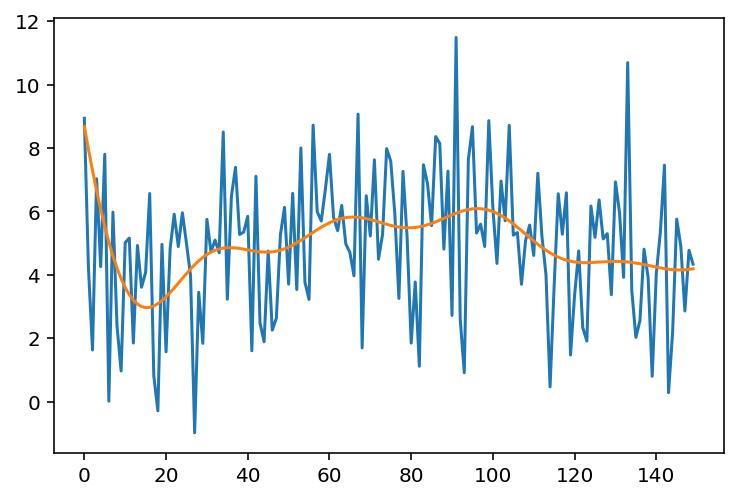

In [358]:
plt.plot(X[i])
plt.plot(x_slow[i])
# plt.plot(fast_filter(X[[i,0]],20,z_sp=3, freq=1, verbose=True, npass=0)[0][0])
# plt.plot(fast_filter(X[[i,0,9,10]],20,z_sp=3, freq=1, verbose=True, npass=3)[0][0])

dilating by 5


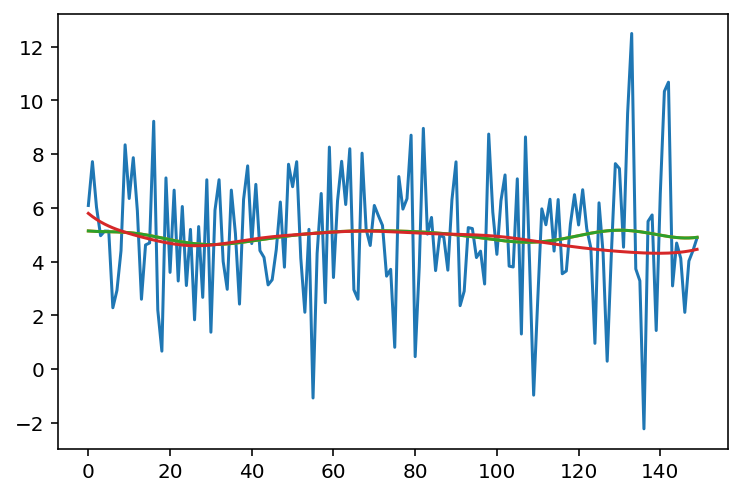

In [343]:
i = 9
plt.plot(X[i])
plt.plot(fast_filter(X[[i,0]],20,z_sp=np.inf, freq=1, verbose=True, npass=0)[0][0])
# plt.plot(fast_filter(X[[i,0]],20,z_sp=3, freq=1, verbose=True, npass=1)[0][0])
# plt.plot(fast_filter(X[[i,0]],20,z_sp=3, freq=1, verbose=True, npass=10)[0][0])
plt.plot(fast_filter(X[[i]+list(range(10))],20,z_sp=3, freq=1, verbose=True, npass=0)[0][0])
# ff = fast_filter(X[[i]+list(range(10))],20,z_sp=3, freq=1, verbose=True, npass=1)
plt.plot(fast_filter(X[[i]+list(range(10))],20,z_sp=3, freq=1, verbose=True, npass=1)[0][0])

dilating by 5
0
10


(70, 156.45)

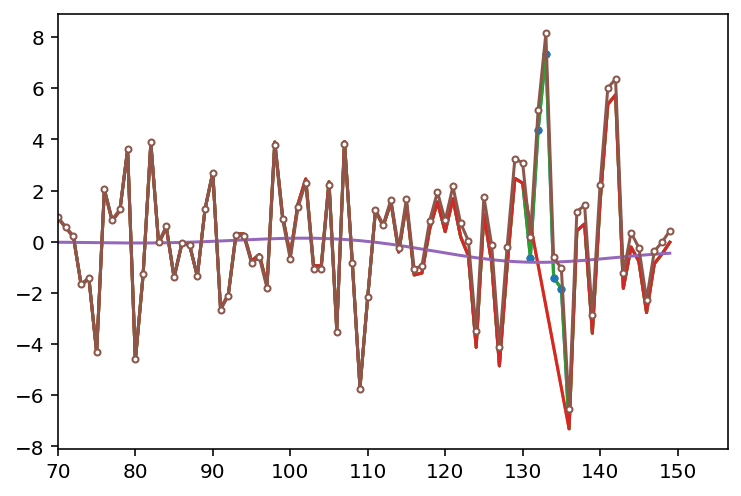

In [332]:
fast_filter(X[[i]+list(range(10))],20,z_sp=3, freq=1, verbose=True, npass=1);
plt.xlim(70,)

dilating by 5
10


(70, 156.45)

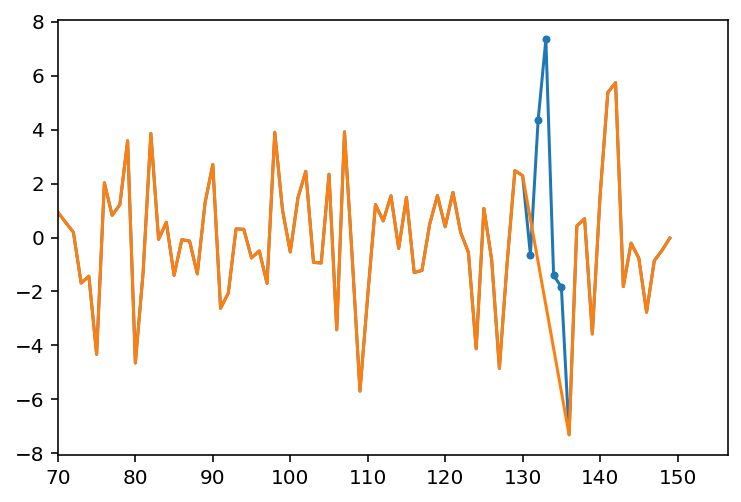

In [325]:
fast_filter(X[[i]+list(range(10))],20,z_sp=3, freq=1, verbose=True, npass=1);
plt.xlim(70,)

In [318]:
ff.sum()


5

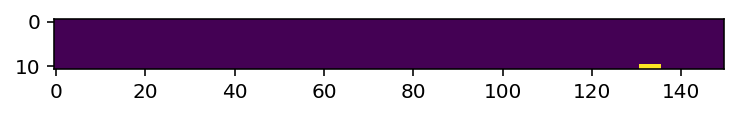

In [319]:
plt.imshow(ff)

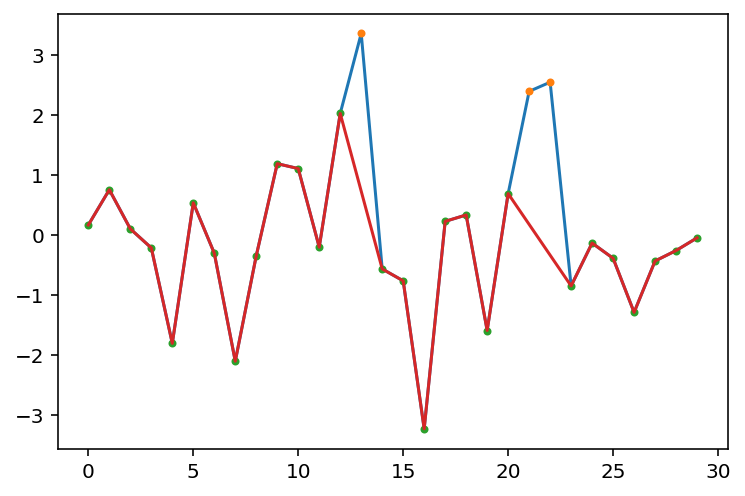

In [310]:
t = np.arange(30)
x = (X[9,-30:]-5)/5**.5
f = x>2.2

plt.plot(t,x)
plt.plot(t[f],x[f],".")
plt.plot(t[~f],x[~f],".")
# y = x.copy()
x[f] = np.interp(t[f], t[~f], x[~f])

plt.plot(t,x)

In [ ]:
np.interp()

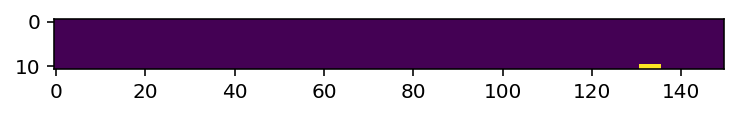

In [286]:
plt.imshow(ff)

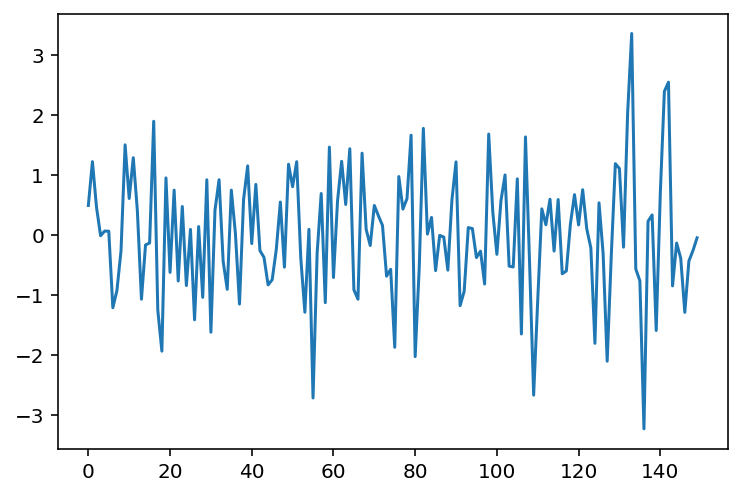

In [288]:
x = 
x
plt.plot()

TypeError: Invalid shape (3, 10, 150) for image data

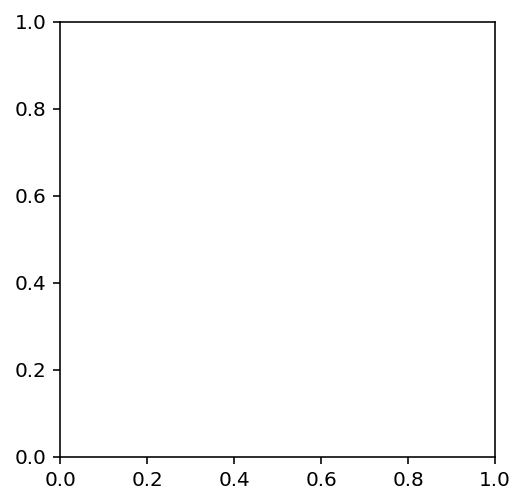

In [282]:
plt.imshow(ff)

dilating by 5
dilating by 5
dilating by 5


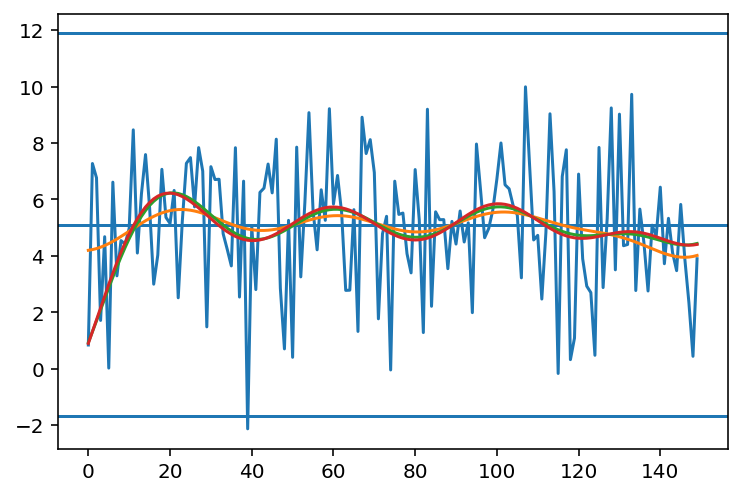

In [262]:
plt.plot(X[i])
m = np.median(X)
for mm in [m, m+3*m**.5, m-3*m**.5]:
    plt.axhline(mm)
x_slow, x_fast, x_z = fast_filter(X,20,z_sp=0, freq=1, verbose=True)
plt.plot(x_slow[i])
x_slow, x_fast, x_z = fast_filter(X,20,z_sp=3, freq=1, verbose=True)
plt.plot(x_slow[i])
x_slow, x_fast, x_z = fast_filter(X,20,z_sp=3, freq=1, verbose=True, npass=2)
plt.plot(x_slow[i])

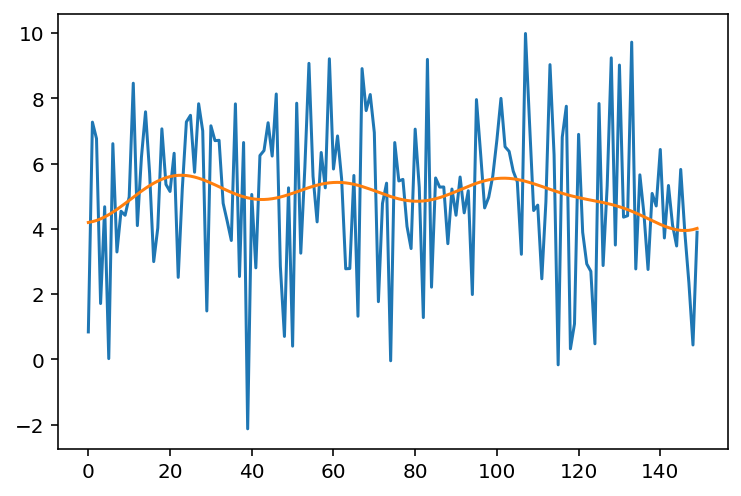

In [241]:
plt.plot(X[i])
plt.plot(x_slow[i])

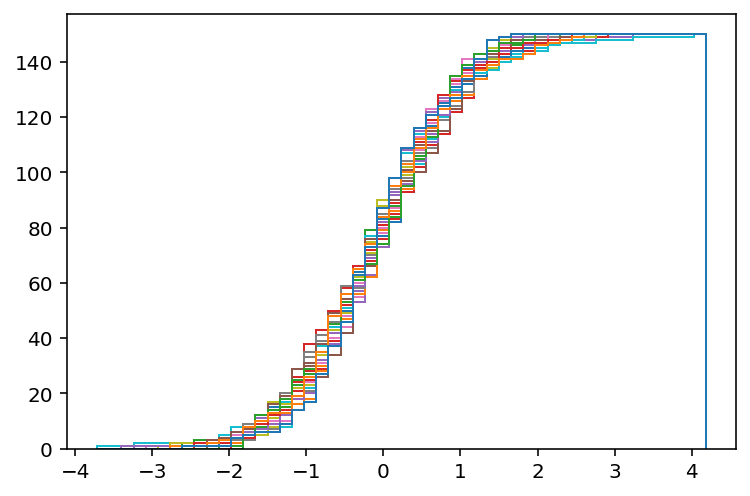

In [190]:
plt.hist(x_z.T, 50, histtype="step", cumulative=True);

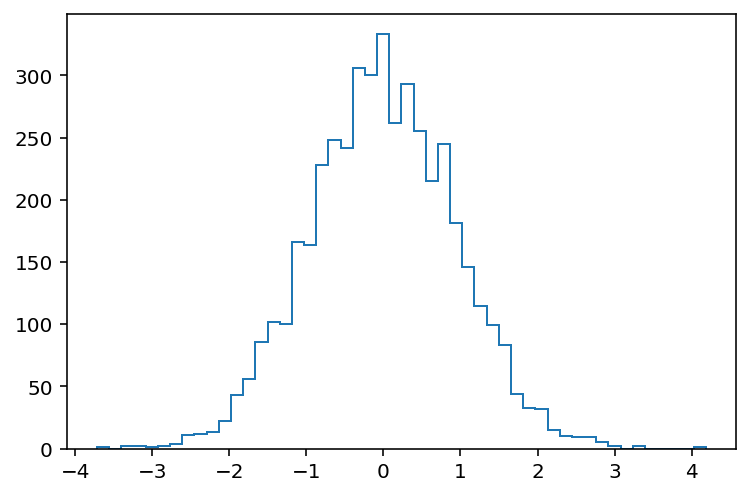

In [191]:
plt.hist(x_z.flat, 50, histtype="step");

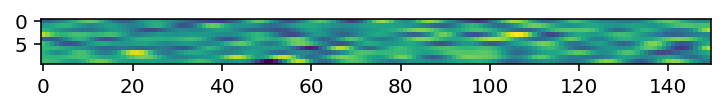

In [163]:
plt.imshow(x_slow)

In [108]:
XF

(array([[ 0.16653807,  0.13753345,  0.11354649, ...,  0.09757153,
          0.04051844, -0.01450214],
        [ 1.31970184,  1.06020678,  0.80895884, ..., -0.26386322,
          0.03628913,  0.3551058 ],
        [-0.00974045, -0.01636744, -0.02696301, ..., -0.8632322 ,
         -1.09317682, -1.3285724 ],
        ...,
        [-0.31159797, -0.29148933, -0.27519224, ...,  0.20901361,
          0.36891205,  0.53089234],
        [-1.35284242, -1.03558128, -0.73827734, ..., -1.19652339,
         -1.53188692, -1.88307422],
        [-0.86191049, -0.84043982, -0.80663419, ..., -0.25560574,
         -0.54128329, -0.83584781]]),
 array([[-3.31850323e-03, -7.70649574e-01, -1.78387068e+00, ...,
         -6.69241159e-01, -5.10871809e-01,  2.44701027e-03],
        [ 1.48497551e-02, -1.54737214e+00, -1.25626028e+00, ...,
          2.79275908e-01, -1.03165696e+00,  4.01171656e-02],
        [-1.76012969e-03, -1.05418803e-01,  4.13246194e-01, ...,
          2.35134085e-01,  1.91558185e+00,  1.21845475e-

In [188]:
rec.import_series(ser, isLineScan=False, onlyMeta=True)

In [193]:
names = rec.Series[ser]["metadata"]["individual Series"]["Name"].values

In [157]:
metadata = rec.Series[ser]["metadata"].copy()

In [158]:
SizeY = metadata.SizeY

In [159]:
nSplit = np.cumsum([n*SizeY for n in metadata["individual Series"]["SizeT"]])
nSplit

array([ 80000, 160000, 240000])

In [160]:
rec.import_series(ser, isLineScan=True)

In [161]:
data = rec.Series[ser]["data"]

In [162]:
metadata = rec.Series[ser]["metadata"].copy()

In [163]:
metadata.Frequency

3960.0

In [164]:
nSplit = np.hstack([[0],nSplit])

In [165]:
times = np.diff(nSplit)/metadata.Frequency

In [166]:
times

array([20.2020202, 20.2020202, 20.2020202])

In [204]:
timeScales = [None,3]#[::-1]

In [205]:
metadata.pxSize

0.85

In [206]:
distance = 20
Tind = 2

In [207]:
tmax = np.max(np.diff(nSplit))/metadata.Frequency
physicalSize = x.shape[0]*metadata.pxSize


In [208]:
from islets.numeric import robust_max

In [209]:
metadata

Name                                                      Series035-37
SizeT                                                           240000
SizeX                                                              512
SizeY                                                                1
pxSize                                                            0.85
pxUnit                                                              µm
bit depth                                                        uint8
Frequency                                                         3960
Start time                                         2019-08-27 11:51:58
End time                                           2019-08-27 11:52:18
Duration                                        0 days 00:00:20.196666
gap                                                                 20
frame_range                                                    (0, 30)
individual Series             Name  SizeT          Start time      ...
Name: 

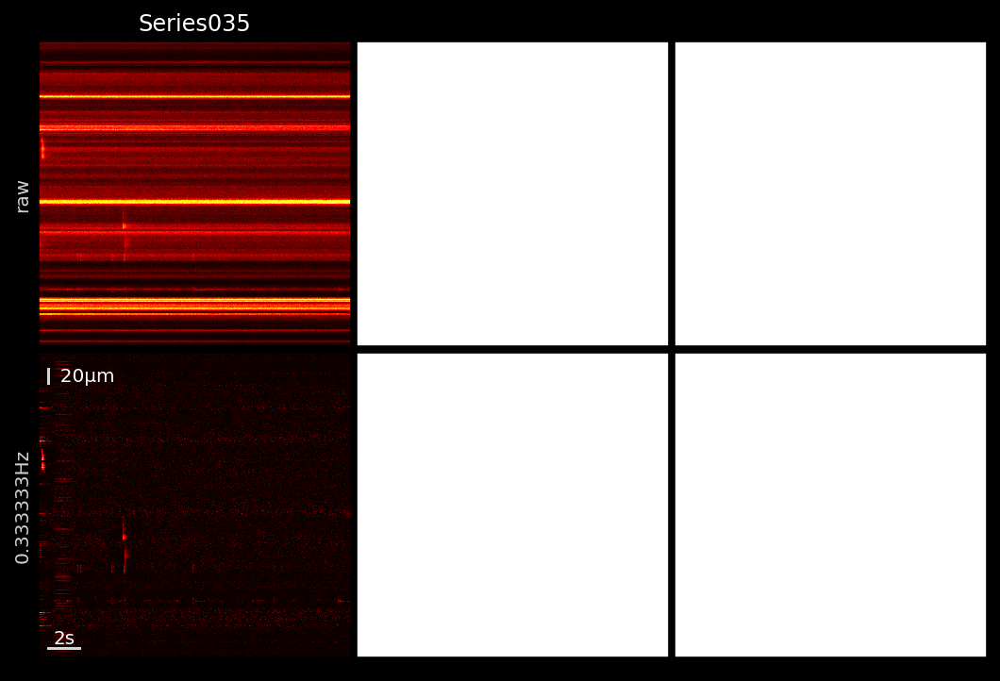

In [213]:
txtOffset = physicalSize*.9
fig, axs = plt.subplots(len(timeScales), len(nSplit)-1, figsize=(len(times)*3,3*len(timeScales)), sharey=True, 
                        sharex=True
                       )
fig.patch.set_facecolor('k')
plt.subplots_adjust(wspace=.02, hspace=.02)
for i in range(len(nSplit)-1):
    x = data[nSplit[i]:nSplit[i+1],0].T.copy()
    for it in range(len(timeScales)):
        ax = axs[it,i]
        ts = timeScales[it]
#         print(it, ts)
        if ts is None:
            txt = "raw"
        else:
            txt = "%gHz"%(1./ts)
            sf = sosFilter(1/ts,metadata.Frequency)
            n = int(1.5*ts*metadata.Frequency)
            x = np.hstack([x[:,:n][:,::-1],x])
            xslow = sf.run(x)[:,n:]
            x = x[:,n:]-xslow
#         x = x - np.percentile(x,.1)
        ax.set_yticks([])
        ax.set_xticks([])
        ax.imshow(rebin(x,10,1),extent=(0, x.shape[1]/metadata.Frequency,0,physicalSize,), aspect="auto", cmap="hot",
#                   vmin=-robust_max(x), vmax=robust_max(x),cmap="bwr",
#                   norm=LogNorm(), 
                  vmin=0
                 )
        if i==0:
            ax.set_ylabel(txt,color="lightgrey")
            if it==len(timeScales)-1:
                ax.plot([tmax*.03]*2,[txtOffset,txtOffset+distance],"lightgrey")
                ax.text(tmax*.03,txtOffset+distance/2,"  "+str(distance)+"µm", va="center", color="w")
                ax.plot([tmax*.03, tmax*.03+Tind],[.03*physicalSize]*2,"lightgrey")
                ax.text(tmax*.03+Tind/2,.03*physicalSize,str(Tind)+"s\n", ha="center", va="center", color="w")
        if it==0:
            ax.set_title(names[i],color='w')

    break


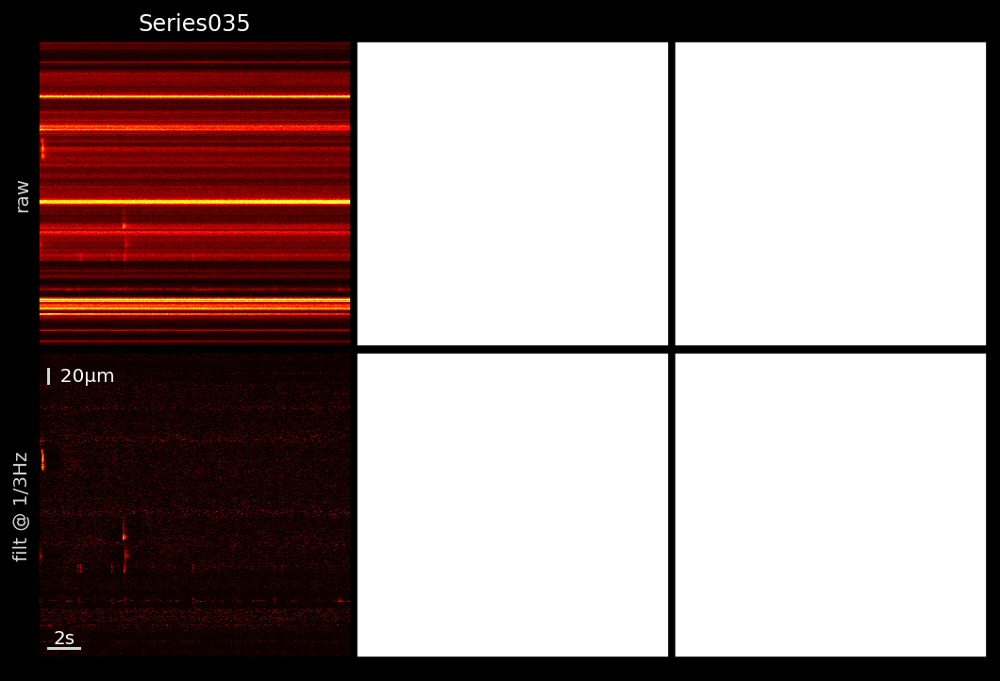

In [217]:
txtOffset = physicalSize*.9
fig, axs = plt.subplots(len(timeScales), len(nSplit)-1, figsize=(len(times)*3,3*len(timeScales)), sharey=True, 
                        sharex=True
                       )
fig.patch.set_facecolor('k')
plt.subplots_adjust(wspace=.02, hspace=.02)
for i in range(len(nSplit)-1):
    x = data[nSplit[i]:nSplit[i+1],0].T.copy()
    for it in range(len(timeScales)):
        ax = axs[it,i]
        ts = timeScales[it]
#         print(it, ts)
        if ts is None:
            txt = "raw"
        else:
            txt = "%g"%(1./ts)  if ts<1 else "1/%g"%ts
            txt = "filt @ %sHz"%txt
            sf = sosFilter(1/ts,metadata.Frequency)
            n = int(ts*metadata.Frequency)
            x = np.hstack([x[:,:n][:,::-1],x])
            xslow = sf.run(x)[:,n:]
            x = x[:,n:]-xslow
#         x = x - np.percentile(x,.1)
        ax.set_yticks([])
        ax.set_xticks([])
        ax.imshow(rebin(x,10,1),extent=(0, x.shape[1]/metadata.Frequency,0,physicalSize,), aspect="auto", cmap="hot",
#                   vmin=-robust_max(x), vmax=robust_max(x),cmap="bwr",
#                   norm=LogNorm(), 
                  vmin=0
                 )
        if i==0:
            ax.set_ylabel(txt,color="lightgrey")
            if it==len(timeScales)-1:
                ax.plot([tmax*.03]*2,[txtOffset,txtOffset+distance],"lightgrey")
                ax.text(tmax*.03,txtOffset+distance/2,"  "+str(distance)+"µm", va="center", color="w")
                ax.plot([tmax*.03, tmax*.03+Tind],[.03*physicalSize]*2,"lightgrey")
                ax.text(tmax*.03+Tind/2,.03*physicalSize,str(Tind)+"s\n", ha="center", va="center", color="w")
        if it==0:
            ax.set_title(names[i],color='w')

    break


In [211]:
x.shape

(512, 68120)

In [212]:
xh = np.hstack([x[:,:n][:,::-1],x])

In [198]:
xh.shape

(512, 103760)

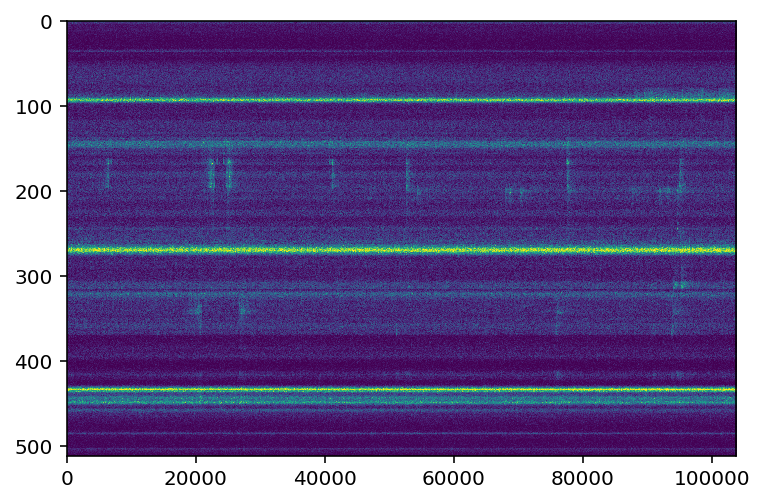

In [201]:
plt.imshow(xh,aspect="auto")

In [130]:
x.shape

(512, 80000)

In [125]:
x.shape

(512, 80000)

In [162]:
ts = .5
sf = sosFilter(1/ts,freq)

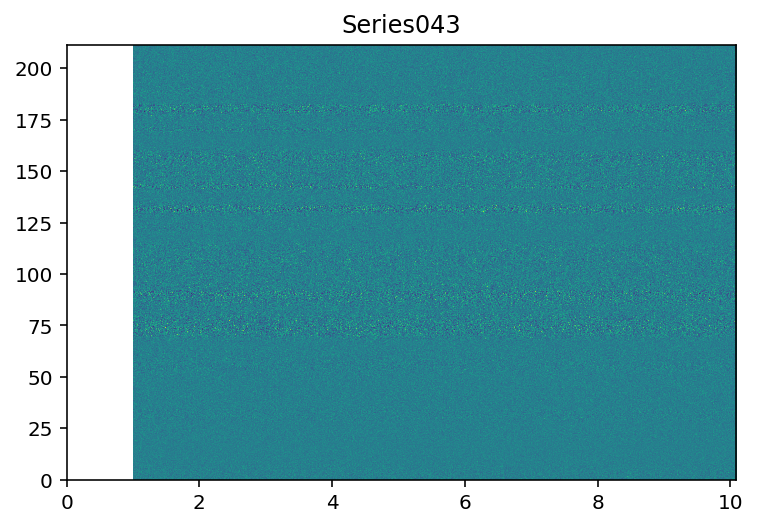

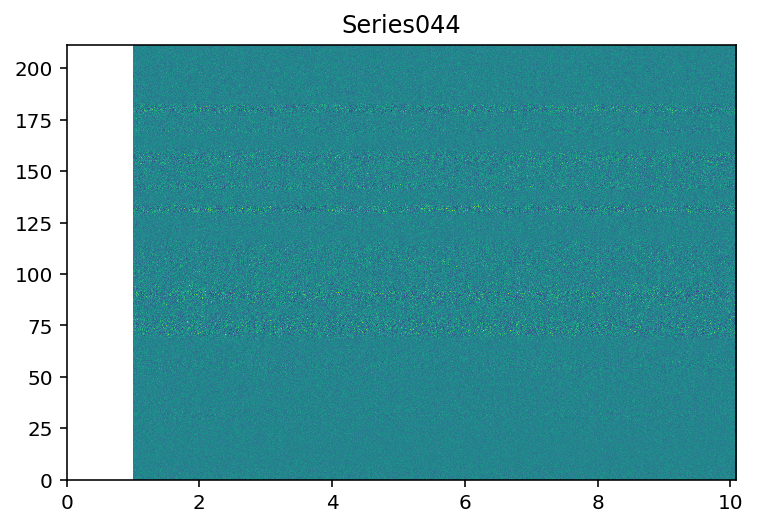

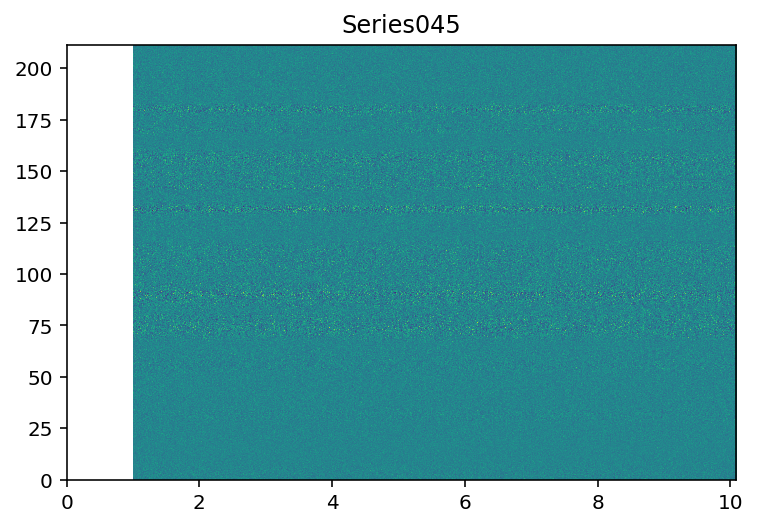

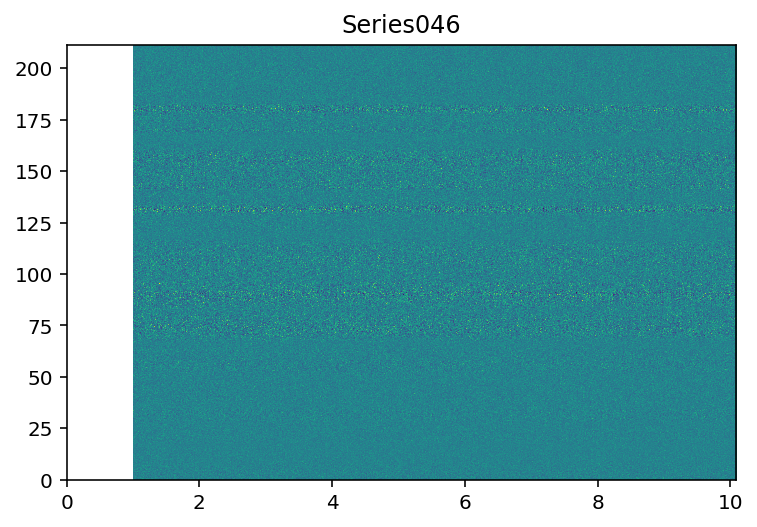

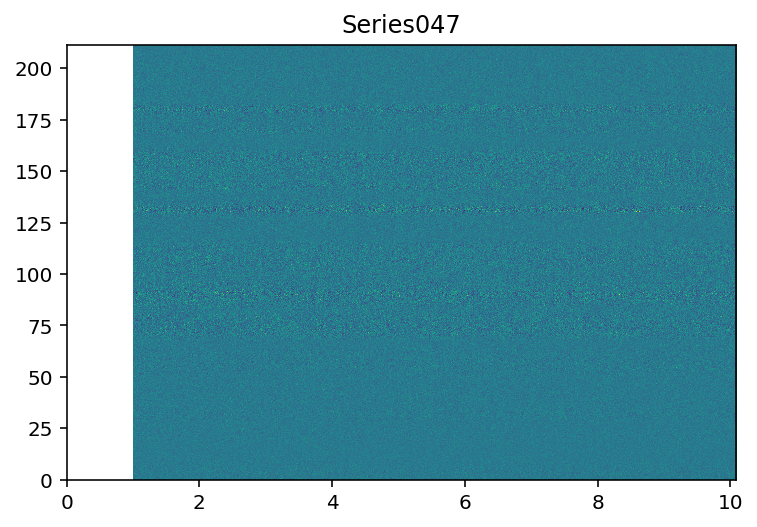

...

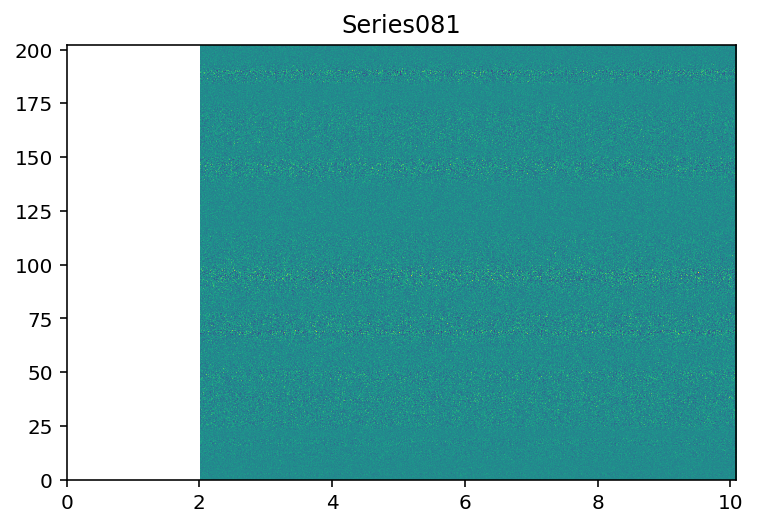

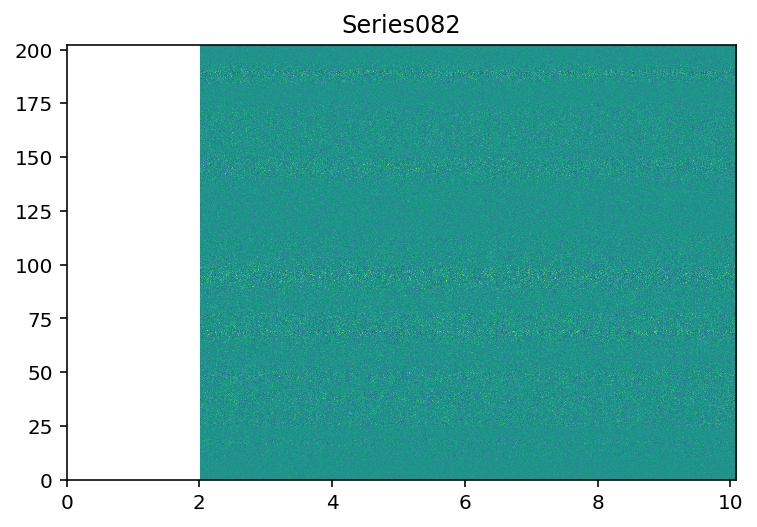

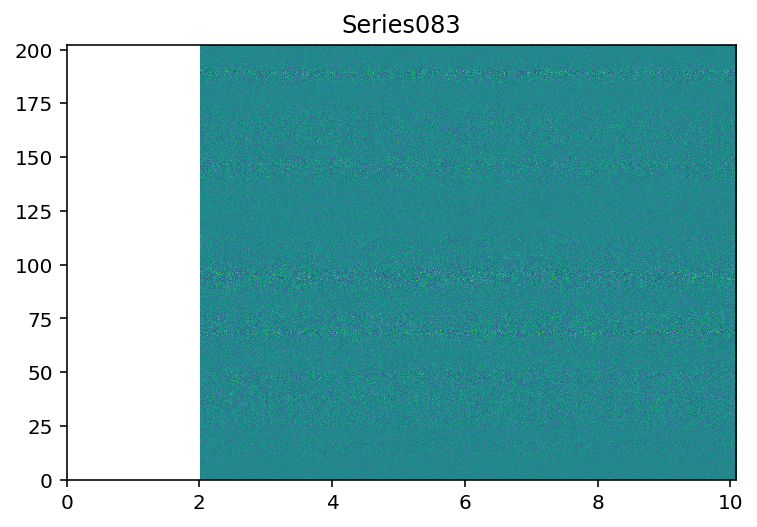

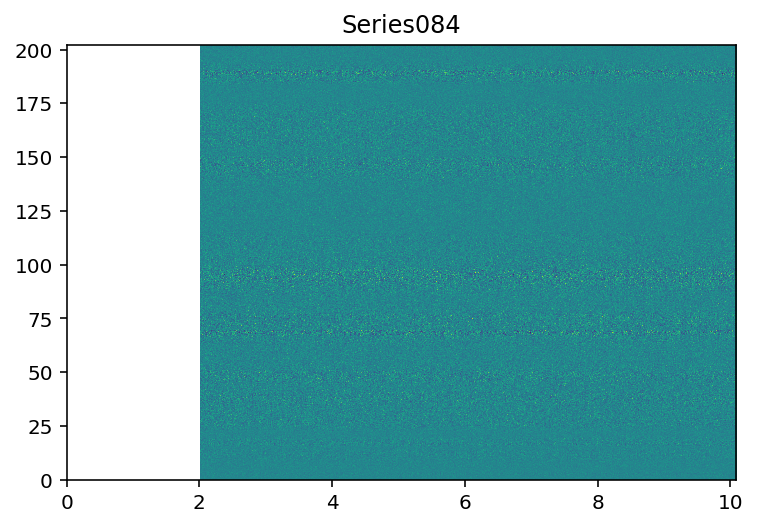

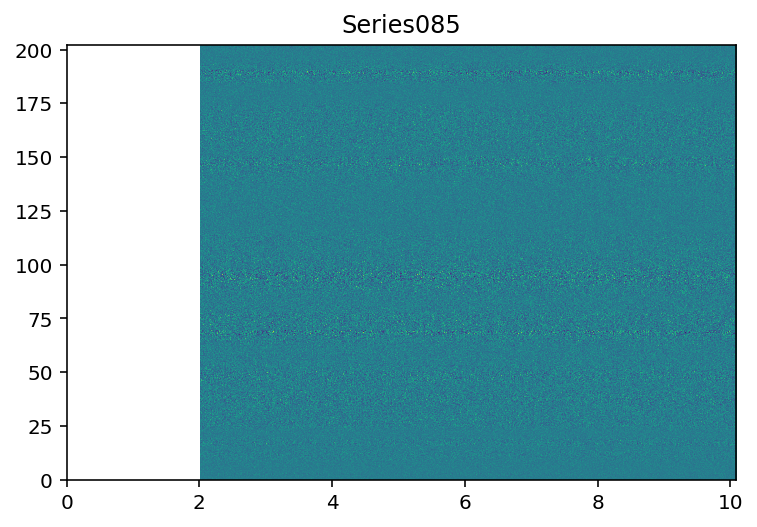

In [164]:
for name in rec.metadata.query("SizeY==8000").Name:
    rec.import_series(name, isLineScan=True)

    data = rec.Series[name]['data'][:,0,]

    freq = rec.Series[name]["metadata"]['Frequency']
    pxSize = rec.Series[name]["metadata"]['pxSize']

    slow = sf.run(data.T).T

    fast = data-slow
    fast[: int(ts*freq*2)] = np.nan

    plt.imshow(rebin(fast,10).T, extent=(0,t.max(),0,data.shape[1]*pxSize))
    plt.gca().set_aspect("auto")
    plt.title(name)
    plt.show()

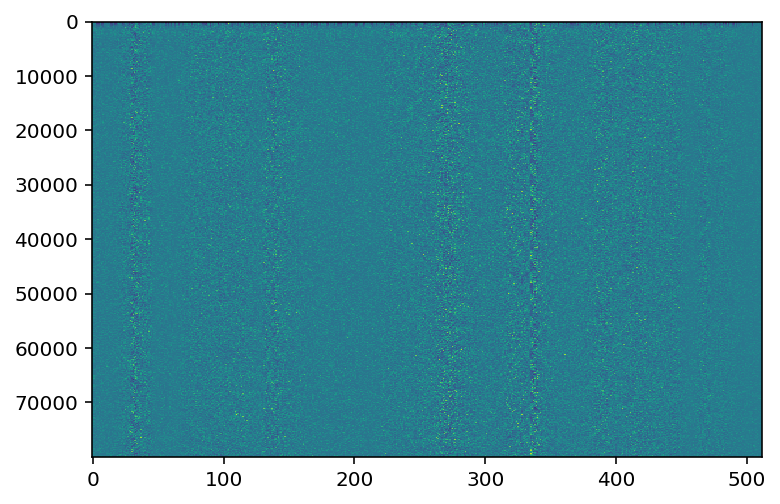

In [166]:
plt.imshow(data-slow)
plt.gca().set_aspect("auto")

In [167]:
t = np.arange(0,len(data))/freq

In [168]:
t.max()

5.050441919191919

array([29, 29, 14, ..., 14, 29, 29], dtype=uint8)

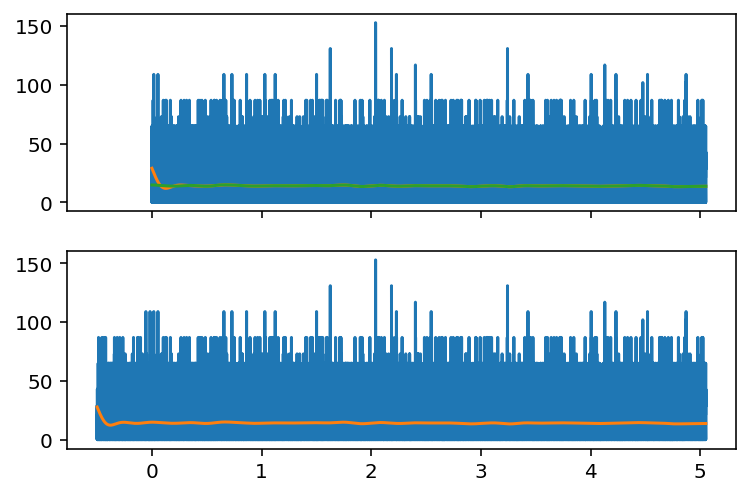

In [195]:
# i = np.argmax(data.mean(0))
fig, axs = plt.subplots(2,1,sharex=True, sharey=True)
i = 200
axs[0].plot(t, data[:,i])
# plt.plot(t, slow[:,i])
axs[0].plot(t, sf.run(data[:,i]))

n = int(ts*freq)
x = np.hstack([data[:n][::-1,i],data[:,i]])
tt = np.hstack([-t[:n][::-1],t])
axs[1].plot(tt,x)
axs[1].plot(tt, sf.run(x))
axs[0].plot(t, sf.run(x)[n:])
# # plt.xlim(0,.5)

In [201]:
data.shape

(80000, 512)

In [202]:
n = int(ts*freq)
x = np.vstack([data[:n][::-1],data])
dataFilt = sf.run(x.T).T[n:]

In [121]:
data.shape

(640000, 1, 512)

In [197]:
dataFilt.shape

(80000, 512)

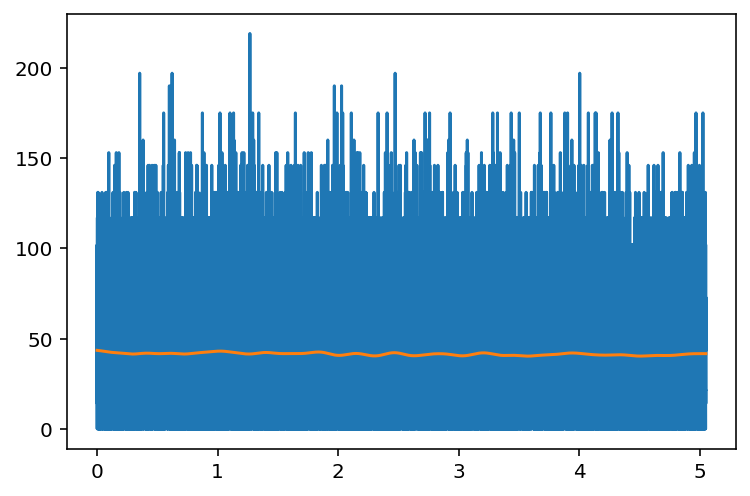

In [200]:
i = 100
plt.plot(t, data[:,i])
plt.plot(t, dataFilt[:,i])

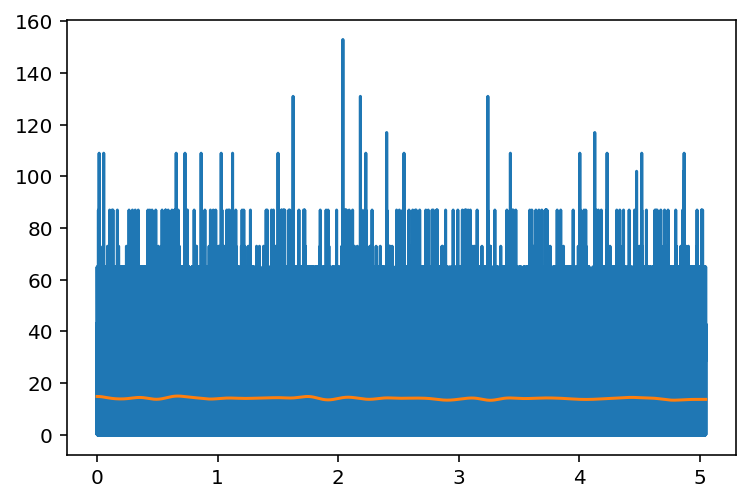

In [204]:
i = 200
plt.plot(t, data[:,i])
plt.plot(t, dataFilt[:,i])

In [205]:
from skimage import io

In [ ]:
io.tiff

In [ ]:
sosFilter(1/3,freq)

In [83]:
dt = 2
N = int(np.ceil(dt*freq))
dN = N//10

In [84]:
movie = np.array([data[i*dN:i*dN+N] for i in range(int((len(data)-N)/dN))])

In [85]:
movie.shape

(42, 159, 512)

In [86]:
show_movie(movie, log=False, NTimeFrames=len(movie))

In [87]:
data

array([[-24.97578  , -21.525782 , -19.32578  , ..., -10.2257805,
         -8.4757805,  -5.3157806],
       [-24.575546 , -21.555546 , -18.525545 , ...,  -8.465546 ,
         -6.0455475,  -6.0455475],
       [-24.02586  , -21.825861 , -19.55586  , ...,  -8.075861 ,
         -5.61586  ,  -5.1058617],
       ...,
       [ 13.01     ,  16.16     ,  17.98     , ...,  28.12     ,
         35.16     ,  30.98     ],
       [ 14.2      ,  17.97     ,  18.23     , ...,  27.35     ,
         32.53     ,  33.9      ],
       [ 13.87     ,  14.56     ,  17.87     , ...,  27.21     ,
         29.06     ,  32.1      ]], dtype=float32)

In [26]:
rec.Series[ser]['metadata']["individual Series"]

,Name,SizeT,Start time,Duration,End time
22,Series044,10,2019-08-13 14:02:53,00:00:10.093332,2019-08-13 14:03:03
23,Series045,10,2019-08-13 14:03:04,00:00:10.093332,2019-08-13 14:03:14


In [14]:
parse_leica(rec, verbose=True)

series grouped as following: [array(['Series005', 'Series006'], dtype=object), array(['Series013'], dtype=object), array(['Series023'], dtype=object), array(['Series026'], dtype=object), array(['Series035'], dtype=object), array(['Series036'], dtype=object), array(['Series037'], dtype=object), array(['Series038'], dtype=object), array(['Series043'], dtype=object), array(['Series044', 'Series045', 'Series046', 'Series047', 'Series048',
       'Series049', 'Series050', 'Series051'], dtype=object), array(['Series052', 'Series053', 'Series054', 'Series055', 'Series056',
       'Series057', 'Series058', 'Series059', 'Series060'], dtype=object), array(['Series061'], dtype=object), array(['Series064', 'Series065', 'Series066', 'Series067', 'Series068',
       'Series069', 'Series070', 'Series071', 'Series072'], dtype=object), array(['Series074', 'Series075'], dtype=object), array(['Series079'], dtype=object), array(['Series080', 'Series081', 'Series082', 'Series083', 'Series084',
       'Seri

['Series005-6',
 'Series013',
 'Series023',
 'Series026',
 'Series035',
 'Series036',
 'Series037',
 'Series038',
 'Series043',
 'Series044-51',
 'Series052-60',
 'Series061',
 'Series064-72',
 'Series074-75',
 'Series079',
 'Series080-85']

In [15]:
rec.metadata

,Name,SizeT,SizeX,SizeY,pxSize,pxUnit,bit depth,Frequency,Start time,End time,Duration,gap
2,Series005,8000,512,512,0.482,µm,uint8,1.980,2019-08-13 09:48:06,2019-08-13 10:55:23,01:07:17.006626,NaN
3,Series006,720,512,512,0.482,µm,uint8,1.980,2019-08-13 10:55:23,2019-08-13 11:01:25,00:06:02.872989,0.0
7,Series013,1954,512,512,0.640,µm,uint8,1.980,2019-08-13 11:11:57,2019-08-13 11:28:22,00:16:25.811508,632.0
10,Series023,4314,512,512,0.553,µm,uint8,1.980,2019-08-13 11:46:05,2019-08-13 12:22:21,00:36:16.978632,1063.0
12,Series026,7413,512,512,0.553,µm,uint8,1.980,2019-08-13 12:28:13,2019-08-13 13:30:34,01:02:21.193681,352.0
17,Series035,6324,512,2,0.413,µm,uint8,596.000,2019-08-13 13:53:29,2019-08-13 13:53:39,00:00:10.618677,1375.0
18,Series036,7481,512,2,0.413,µm,uint8,769.000,2019-08-13 13:55:37,2019-08-13 13:55:46,00:00:09.731300,118.0
19,Series037,20,512,8192,0.413,µm,uint8,1.930,2019-08-13 13:57:15,2019-08-13 13:57:25,00:00:10.336841,89.0
20,Series038,20,512,8192,0.413,µm,uint8,1.930,2019-08-13 13:58:23,2019-08-13 13:58:33,00:00:10.336841,58.0
21,Series043,10,512,8000,0.413,µm,uint8,0.991,2019-08-13 14:02:19,2019-08-13 14:02:29,00:00:10.094445,226.0


In [27]:
from ExpLorer_4 import Recording

#################### /data/Sandra/2020/2020_07_08/Experiment59a.lif
#################### /data/Sandra/2020/2020_07_08/Experiment59b.lif
#################### /data/Sandra/2020/2020_07_08/Experiment59c.lif
#################### /data/Sandra/2020/2020_07_08/Experiment59d.lif


/home/srdjan/github/Physio_Ca/app/ExpLorer_4.py:262: UserWarning:

DataFrame columns are not unique, some columns will be omitted.



In [28]:
Recording("/data/Johannes/2020_08_06/Experiment003h.nd2")

Recording /data/Johannes/2020_08_06/Experiment003h.nd2 not yet preprocessed. Preprocessing takes a few seconds and will speed up the usage later... 

AttributeError: 'NoneType' object has no attribute 'find_class'

In [14]:
status = import_data(startFolder,"")

#################### /data/Sandra/2020/2020_07_08/Experiment59a.lif
#################### /data/Sandra/2020/2020_07_08/Experiment59b.lif
#################### /data/Sandra/2020/2020_07_08/Experiment59c.lif
#################### /data/Sandra/2020/2020_07_08/Experiment59d.lif


In [15]:
status.columns

Index(['path to exp', 'experiment', 'series', 'SizeT', 'SizeX', 'SizeY',
       'SizeZ', 'pxSize', 'pxUnit', 'Frequency', 'Duration', 'gap',
       'Time Range', 'Duration [s]', 'path to movie', 'movie done', 'date',
       'Series Durations', 'pickles done', 'path to protocol', 'protocol done',
       'protocol', 'path to add_info', 'add_info done', 'comments', 'sex',
       'strain', 'species', 'dye', 'slice number', 'part of pancreas',
       'microscope', 'movie size [MB]'],
      dtype='object')

In [9]:
[el.keys() for el in status]

[dict_keys(['path to exp', 'experiment', 'series', 'SizeT', 'SizeX', 'SizeY', 'SizeZ', 'pxSize', 'pxUnit', 'Frequency', 'Duration', 'gap', 'Time Range', 'Duration [s]', 'path to movie', 'movie done', 'date', 'Series Durations', 'pickles done', 'path to protocol', 'protocol done', 'protocol', 'path to add_info', 'add_info done', 'frame_range']),
 dict_keys(['path to exp', 'experiment', 'series', 'SizeT', 'SizeX', 'SizeY', 'SizeZ', 'pxSize', 'pxUnit', 'Frequency', 'Duration', 'gap', 'Time Range', 'Duration [s]', 'path to movie', 'movie done', 'movie size [MB]', 'date', 'Series Durations', 'pickles done', 'path to protocol', 'protocol done', 'protocol', 'path to add_info', 'add_info done', 'frame_range'])]

In [37]:
status.columns

Index(['path to exp', 'experiment', 'series', 'SizeT', 'SizeX', 'SizeY',
       'SizeZ', 'pxSize', 'pxUnit', 'Frequency', 'Duration', 'gap',
       'Time Range', 'Duration [s]', 'path to movie', 'movie done',
       'movie size [MB]', 'date', 'Series Durations', 'pickles done',
       'path to protocol', 'protocol done', 'protocol', 'path to add_info',
       'add_info done', 'frame_range'],
      dtype='object')

In [19]:
a = df[["path to add_info", "add_info done"]].loc[3]
a.values

array(['/data/Sandra/2020/2020_07_08/Experiment59b.lif_analysis/Series002-5/additional_info.txt',
       True], dtype=object)

In [ ]:
/data/Sandra/2020/2020_07_08/Experiment59b.lif_analysis/Series002-5/additional_info.txt

In [37]:
# [
#                 {'if': {'column_id': 'Duration [s]'}, 'format': '%.1f'},
#                 {'if': {'column_id': 'date'        }}.update({ k:  '30px' for k in ['width','minWidth','maxWidth'] }),
#                 {'if': {'column_id': 'experiment'  }}.update({ k:  '50px' for k in ['width','minWidth','maxWidth'] }),
#                 {'if': {'column_id': 'series'      }}.update({ k:  '60px' for k in ['width','minWidth','maxWidth'] }),
#                 {'if': {'column_id': 'comments'    }}.update({ k: '150px' for k in ['width','minWidth','maxWidth'] }),
#                 {'if': {'column_id': 'protocol'    }}.update({ k: '150px' for k in ['width','minWidth','maxWidth'] }),
#             ]

In [22]:
from islets.Regions1 import Regions

In [25]:
import pandas as pd

In [28]:
prot

,compound,concentration,begin,end
0,glucose,8mM,NaN,NaN
1,pH,7.4,NaN,59:00
2,pH,7.1,59:00,NaN


'glucose:8mM, pH:7.4, pH:7.1'

In [24]:
protFile = Regions.import_protocol(None, protocolFile)

AttributeError: 'NoneType' object has no attribute 'protocol'

In [21]:
protocolFile

'/data/Sandra/2020/2020_07_08/Experiment59a.lif_analysis/Series003-4_0-5160s/Experiment59a.lif_Series003-4_0-5160s_protocol.txt'